In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

from datetime import timedelta, datetime
#import holidays

import matplotlib
import pickle

In [2]:
import plotly.express as px
import matplotlib.pyplot as plt

In [3]:
matplotlib.pyplot.style.use('ggplot')
%matplotlib inline

In [4]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.6f' % x)
pd.set_option('display.width', 500)

In [5]:
targets_train = pd.read_csv('../data/targets_train.csv')
uf_test = pd.read_csv('../data/user_features_test.csv')
uf_train = pd.read_csv('../data/user_features_train.csv')
users_test = pd.read_csv('../data/users_test.csv')
users_train = pd.read_csv('../data/users_train.csv')

In [6]:
df_train = pd.merge(targets_train, users_train, on='ID')

In [7]:
df_train = pd.merge(df_train, uf_train, on='ID')

In [8]:
df_test = pd.merge(users_test, uf_test, on='ID')

In [9]:
df_train.shape

(878594, 87)

In [10]:
df_test.shape

(585730, 86)

In [11]:
df_train['log_first_prediction'] = np.log(df_train['first_prediction'] + 0.00001)

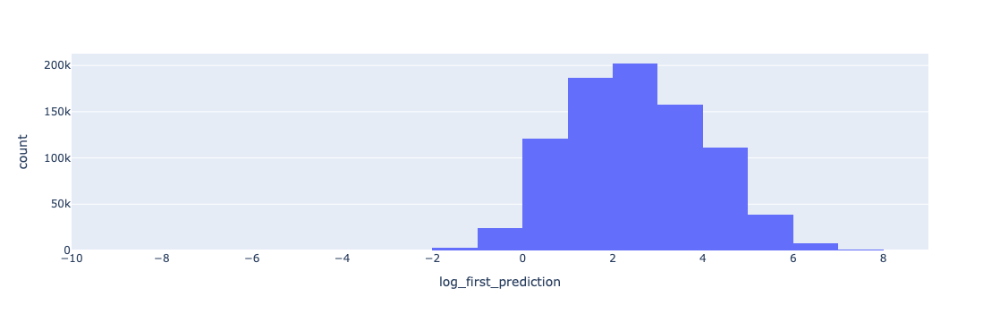

In [12]:
fig = px.histogram(df_train, x="log_first_prediction", nbins=20)
fig.show()

In [13]:
df_train['log_first_prediction'].describe()

count   852859.000000
mean         2.501911
std          1.512790
min         -9.114879
25%          1.369292
50%          2.434890
75%          3.580081
max          8.506026
Name: log_first_prediction, dtype: float64

In [14]:
df_train['economic_class'] = np.where((0.0 > round(df_train['log_first_prediction'], 1)), 'poor', 'Nan')
df_train['economic_class'] = np.where((0.0 <= round(df_train['log_first_prediction'], 1)) & 
                                      ((round(df_train['log_first_prediction'], 1) < 2.5)), 'lower_middle_class', df_train['economic_class'])
df_train['economic_class'] = np.where((2.5 <= round(df_train['log_first_prediction'], 1)) & 
                                      ((round(df_train['log_first_prediction'], 1) <= 5.0)), 'upper_middle_class', df_train['economic_class'])
df_train['economic_class'] = np.where((5.0 < round(df_train['log_first_prediction'], 1)), 'wealthy', df_train['economic_class'])

In [15]:
df_train['economic_class'].value_counts()

economic_class
lower_middle_class    404918
upper_middle_class    387587
wealthy                35752
Nan                    25735
poor                   24602
Name: count, dtype: int64

In [16]:
LvlDuration_cols = ['Level_1_Duration', 'Level_2_Duration', 'Level_3_Duration', 'Level_4_Duration', 'Level_5_Duration', 
                   'Level_6_Duration', 'Level_7_Duration', 'Level_8_Duration', 'Level_9_Duration', 'Level_10_Duration']

df_train[LvlDuration_cols] = df_train[LvlDuration_cols].fillna(0.0)

df_train['Retention_count_D0_3'] = (df_train['RetentionD0'].astype(int) + df_train['RetentionD1'].astype(int) + 
                                        df_train['RetentionD2'].astype(int) + df_train['RetentionD3'].astype(int))
df_train['Retention_count_D4_7'] = (df_train['RetentionD4'].astype(int) + df_train['RetentionD5'].astype(int) + 
                                        df_train['RetentionD6'].astype(int) + df_train['RetentionD7'].astype(int))

df_train['Retention_count_D8_11'] = (df_train['RetentionD8'].astype(int) + df_train['RetentionD9'].astype(int) + 
                                        df_train['RetentionD10'].astype(int) + df_train['RetentionD11'].astype(int))

df_train['Retention_count_D12_15'] = (df_train['RetentionD12'].astype(int) + df_train['RetentionD13'].astype(int) + 
                                        df_train['RetentionD14'].astype(int) + df_train['RetentionD15'].astype(int))
df_train['Avg_Lvl_Count_D0_3'] = (df_train['LevelAdvancedCountD0'] + df_train['LevelAdvancedCountD1'] +
                                 df_train['LevelAdvancedCountD2'] + df_train['LevelAdvancedCountD3']) / 4.0
df_train['Avg_Lvl_Count_D4_7'] = (df_train['LevelAdvancedCountD4'] + df_train['LevelAdvancedCountD5'] +
                                 df_train['LevelAdvancedCountD6'] + df_train['LevelAdvancedCountD7']) / 4.0

df_train['Avg_Lvl_Count_D8_11'] = (df_train['LevelAdvancedCountD8'] + df_train['LevelAdvancedCountD9'] +
                                 df_train['LevelAdvancedCountD10'] + df_train['LevelAdvancedCountD11']) / 4.0

df_train['Avg_Lvl_Count_D12_15'] = (df_train['LevelAdvancedCountD12'] + df_train['LevelAdvancedCountD13'] +
                                 df_train['LevelAdvancedCountD14'] + df_train['LevelAdvancedCountD15']) / 4.0
df_train['Avg_Duration_Lvl0_3'] = (df_train['Level_1_Duration'] + df_train['Level_2_Duration'] +
                                 df_train['Level_3_Duration']) / 3.0

df_train['Avg_Duration_Lvl4_7'] = (df_train['Level_4_Duration'] + df_train['Level_5_Duration'] +
                                 df_train['Level_6_Duration'] + df_train['Level_7_Duration']) / 4.0

df_train['Avg_Duration_Lvl8_10'] = (df_train['Level_8_Duration'] + df_train['Level_9_Duration'] +
                                 df_train['Level_10_Duration']) / 3.0
df_train['Total_AdRevenueD0_3'] = (df_train['AdRevenueD0'] + df_train['AdRevenueD1'] + 
                                        df_train['AdRevenueD2'] + df_train['AdRevenueD3'])

df_train['Total_AdRevenueD4_7'] = (df_train['AdRevenueD4'] + df_train['AdRevenueD5'] + 
                                        df_train['AdRevenueD6'] + df_train['AdRevenueD7'])

df_train['Total_AdRevenueD8_11'] = (df_train['AdRevenueD8'] + df_train['AdRevenueD9'] + 
                                        df_train['AdRevenueD10'] + df_train['AdRevenueD11'])

df_train['Total_AdRevenueD12_15'] = (df_train['AdRevenueD12'] + df_train['AdRevenueD13'] + 
                                        df_train['AdRevenueD14'] + df_train['AdRevenueD15'])
df_train['Total_IAPRevenueD0_3'] = (df_train['IAPRevenueD0'] + df_train['IAPRevenueD1'] + 
                                        df_train['IAPRevenueD2'] + df_train['IAPRevenueD3'])

df_train['Total_IAPRevenueD4_7'] = (df_train['IAPRevenueD4'] + df_train['IAPRevenueD5'] + 
                                        df_train['IAPRevenueD6'] + df_train['IAPRevenueD7'])

df_train['Total_IAPRevenueD8_11'] = (df_train['IAPRevenueD8'] + df_train['IAPRevenueD9'] + 
                                        df_train['IAPRevenueD10'] + df_train['IAPRevenueD11'])

df_train['Total_IAPRevenueD12_15'] = (df_train['IAPRevenueD12'] + df_train['IAPRevenueD13'] + 
                                        df_train['IAPRevenueD14'] + df_train['IAPRevenueD15'])
df_train['Total_AdRevenue'] = df_train['Total_AdRevenueD0_3'] + df_train['Total_AdRevenueD4_7'] + df_train['Total_AdRevenueD8_11'] + df_train['Total_AdRevenueD12_15']

df_train['Total_IAPRevenue'] = df_train['Total_IAPRevenueD0_3'] + df_train['Total_IAPRevenueD4_7'] + df_train['Total_IAPRevenueD8_11'] + df_train['Total_IAPRevenueD12_15']

df_train['first_open_date'] = pd.to_datetime(df_train['first_open_date'], format='%Y-%m-%d')

df_train['open_year'] = df_train['first_open_date'].apply(lambda x:x.year)
df_train['open_month'] = df_train['first_open_date'].apply(lambda x:x.month)

In [17]:
df_train['TARGET'] = df_train['TARGET'] - (df_train['Total_AdRevenue'] + df_train['Total_IAPRevenue'])
df_train['log_TARGET'] = np.log(df_train['TARGET']+ 0.000001)

In [18]:
df_train_grande = df_train.copy()

In [19]:
df_train = df_train[['ID', 'TARGET', 'open_year', 'open_month', 'first_prediction', 'log_first_prediction', 'economic_class', 'log_TARGET',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15', 'Avg_Duration_Lvl0_3',
         'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 'Total_AdRevenueD0_3', 'Total_AdRevenueD4_7', 'Total_AdRevenueD8_11', 
         'Total_AdRevenueD12_15', 'Total_IAPRevenueD0_3', 'Total_IAPRevenueD4_7', 'Total_IAPRevenueD8_11', 'Total_IAPRevenueD12_15', 
                       'Total_AdRevenue', 'Total_IAPRevenue']]

In [20]:
df_train.groupby('economic_class')['TARGET'].mean()

economic_class
Nan                  0.016357
lower_middle_class   0.065885
poor                 0.028112
upper_middle_class   0.244419
wealthy              0.944412
Name: TARGET, dtype: float64

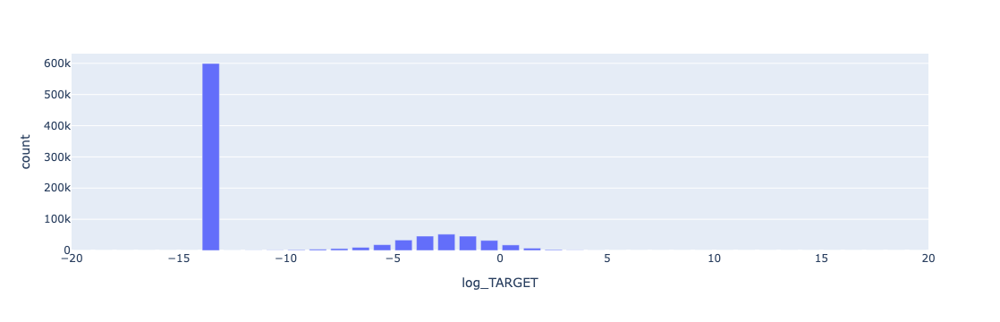

In [25]:
counts, bins = np.histogram(df_train['log_TARGET'], bins=range(-20, 21, 1))
bins = bins + 10
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 10
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

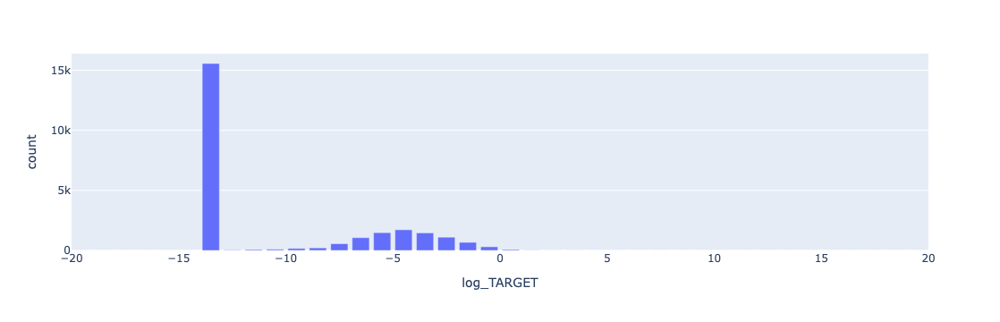

In [26]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'poor']['log_TARGET'], bins=range(-20, 21, 1))
bins = bins + 10
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 10
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

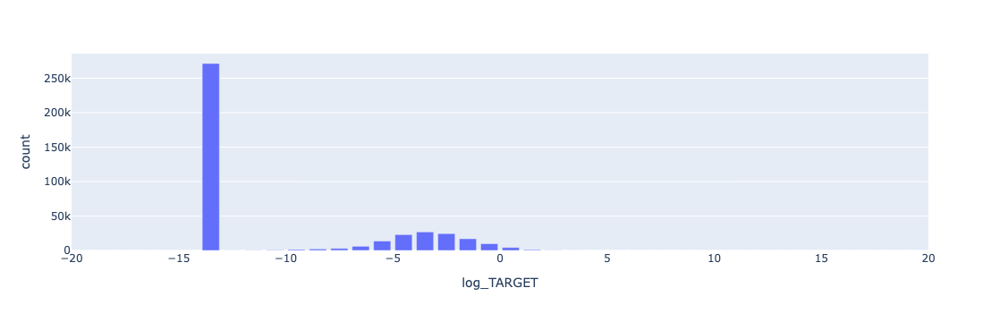

In [27]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'lower_middle_class']['log_TARGET'], bins=range(-20, 21, 1))
bins = bins + 10
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 10
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

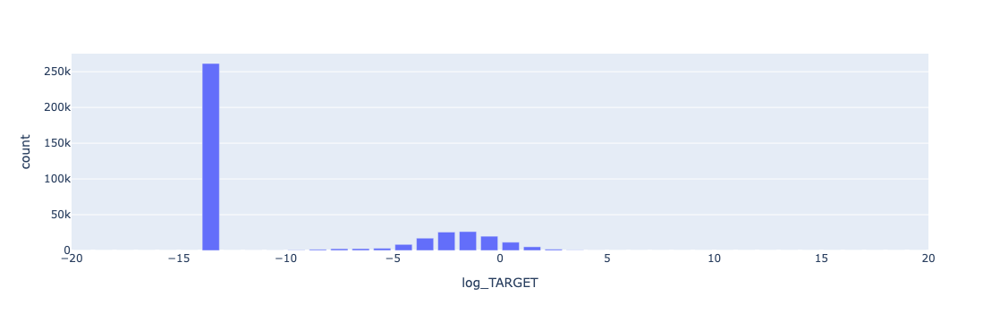

In [28]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'upper_middle_class']['log_TARGET'], bins=range(-20, 21, 1))
bins = bins + 10
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 10
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

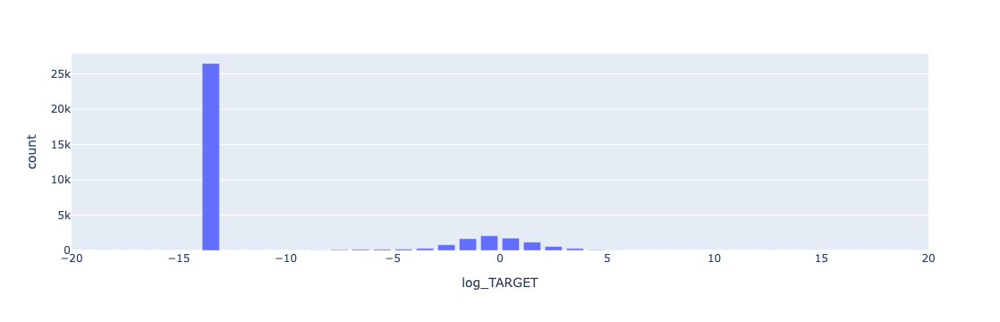

In [29]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'wealthy']['log_TARGET'], bins=range(-20, 21, 1))
bins = bins + 10
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 10
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

In [30]:
df_train_grande.head()

,ID,TARGET,first_open_date,first_open_timestamp,local_first_open_timestamp,country,platform,device_category,device_brand,device_model,has_ios_att_permission,ad_network,first_prediction,RetentionD0,RetentionD1,RetentionD2,RetentionD3,RetentionD4,RetentionD5,RetentionD6,RetentionD7,RetentionD8,RetentionD9,RetentionD10,RetentionD11,RetentionD12,RetentionD13,RetentionD14,RetentionD15,LevelAdvancedCountD0,LevelAdvancedCountD1,LevelAdvancedCountD2,LevelAdvancedCountD3,LevelAdvancedCountD4,LevelAdvancedCountD5,LevelAdvancedCountD6,LevelAdvancedCountD7,LevelAdvancedCountD8,LevelAdvancedCountD9,LevelAdvancedCountD10,LevelAdvancedCountD11,LevelAdvancedCountD12,LevelAdvancedCountD13,LevelAdvancedCountD14,LevelAdvancedCountD15,Level_1_Duration,Level_2_Duration,Level_3_Duration,Level_4_Duration,Level_5_Duration,Level_6_Duration,Level_7_Duration,Level_8_Duration,Level_9_Duration,Level_10_Duration,AdRevenueD0,AdRevenueD1,AdRevenueD2,AdRevenueD3,AdRevenueD4,AdRevenueD5,AdRevenueD6,AdRevenueD7,AdRevenueD8,AdRevenueD9,AdRevenueD10,AdRevenueD11,AdRevenueD12,AdRevenueD13,AdRevenueD14,AdRevenueD15,IAPRevenueD0,IAPRevenueD1,IAPRevenueD2,IAPRevenueD3,IAPRevenueD4,IAPRevenueD5,IAPRevenueD6,IAPRevenueD7,IAPRevenueD8,IAPRevenueD9,IAPRevenueD10,IAPRevenueD11,IAPRevenueD12,IAPRevenueD13,IAPRevenueD14,IAPRevenueD15,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,open_year,open_month
0,0,0.000,2024-03-02,1709355895042000,1709334295042000,Mexico,Android,mobile,Xiaomi,Redmi A2,False,unityads_int,3.314,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,26.000,69.000,36.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.198,lower_middle_class,-6.908,1,0,0,1,0.750,0.000,0.000,0.000,43.667,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2024,3
1,1,0.019,2024-03-19,1710824539731000,1710806539731000,Peru,Android,mobile,Samsung,Galaxy A13,False,applovin_int,1.682,True,False,False,False,False,False,True,True,False,True,False,False,False,False,False,False,5,0,0,0,0,0,3,5,0,2,0,0,0,0,0,0,13.000,91.000,39.000,79.000,180.000,89.000,124.000,118.000,35.000,117.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.009,0.000,0.010,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.520,lower_middle_class,-3.917,1,2,1,0,1.250,2.000,0.500,0.000,47.667,118.000,90.000,0.000,0.009,0.010,0.000,0.000,0.000,0.000,0.000,0.019,0.000,2024,3
2,2,0.000,2024-03-18,1710731043082000,1710720243082000,Brazil,Android,mobile,Xiaomi,Redmi 12,False,applovin_int,10.719,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8.000,63.000,86.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2.372,lower_middle_class,-6.908,1,0,0,0,0.750,0.000,0.000,0.000,52.333,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,2024,3
3,3,0.047,2024-03-03,1709455862260000,1709441462260000,Dominican Republic,iOS,mobile,Apple,iPhone 11 Pro Max,False,NaN,5.100,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,19,8,9,0,0,0,0,

In [31]:
df_train.head()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
0,0,0.000,2024,3,3.314,1.198,lower_middle_class,-6.908,1,0,0,1,0.750,0.000,0.000,0.000,43.667,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,1,0.019,2024,3,1.682,0.520,lower_middle_class,-3.917,1,2,1,0,1.250,2.000,0.500,0.000,47.667,118.000,90.000,0.000,0.009,0.010,0.000,0.000,0.000,0.000,0.000,0.019,0.000
2,2,0.000,2024,3,10.719,2.372,lower_middle_class,-6.908,1,0,0,0,0.750,0.000,0.000,0.000,52.333,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,3,0.047,2024,3,5.100,1.629,lower_middle_class,-3.044,3,0,0,0,9.000,0.000,0.000,0.000,98.333,94.750,126.667,0.047,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.047,0.000
4,4,0.015,2024,4,2.091,0.738,lower_middle_class,-4.155,1,0,0,0,3.750,0.000,0.000,0.000,30.000,146.750,87.667,0.015,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.015,0.000


In [42]:
df_train.describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,878594.000,878594.000,878594.000,878594.000,852859.000,852859.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000,878594.000
mean,439296.500,0.178,2024.000,2.924,37.612,2.502,-5.552,1.927,0.731,0.524,0.427,5.393,1.813,1.223,0.981,78.411,113.567,84.004,0.200,0.061,0.039,0.030,0.002,0.000,0.000,0.000,0.330,0.002
std,253628.386,1.770,0.000,1.385,87.799,1.512,2.299,1.055,1.162,1.021,0.937,8.790,6.096,5.002,4.566,506.256,141.577,217.316,0.804,0.397,0.329,0.290,0.078,0.033,0.024,0.024,1.432,0.103
min,0.000,-0.000,2024.000,1.000,0.000,-6.812,-6.908,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,219648.250,0.000,2024.000,2.000,3.933,1.370,-6.908,1.000,0.000,0.000,0.000,1.250,0.000,0.000,0.000,31.000,33.500,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
50%,439296.500,0.000,2024.000,3.000,11.415,2.435,-6.908,2.000,0.000,0.000,0.000,2.750,0.000,0.000,0.000,54.333,90.750,66.000,0.010,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.023,0.000
75%,658944.750,0.012,2024.000,4.000,35.876,3.580,-4.323,3.000,1.000,1.000,0.000,5.500,0.750,0.000,0.000,93.333,155.500,122.667,0.113,0.006,0.000,0.000,0.000,0.000,0.000,0.000,0.193,0.000
max,878593.000,386.494,2024.000,5.000,4944.477,8.506,5.957,4.000,4.000,4.000,4.000,353.000,299.750,296.250,312.750,328605.667,12569.000,165415.667,91.707,56.354,85.260,101.214,27.950,10.400,5.200,6.500,295.808,27.950


In [43]:
df_train[(round(df_train['log_TARGET'], 1) <= -6.0)].head(20)

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
0,0,0.000,2024,3,3.314,1.198,lower_middle_class,-6.908,1,0,0,1,0.750,0.000,0.000,0.000,43.667,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,1,0.000,2024,3,1.682,0.520,lower_middle_class,-6.908,1,2,1,0,1.250,2.000,0.500,0.000,47.667,118.000,90.000,0.000,0.009,0.010,0.000,0.000,0.000,0.000,0.000,0.019,0.000
2,2,0.000,2024,3,10.719,2.372,lower_middle_class,-6.908,1,0,0,0,0.750,0.000,0.000,0.000,52.333,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,3,0.000,2024,3,5.100,1.629,lower_middle_class,-6.908,3,0,0,0,9.000,0.000,0.000,0.000,98.333,94.750,126.667,0.047,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.047,0.000
4,4,0.000,2024,4,2.091,0.738,lower_middle_class,-6.908,1,0,0,0,3.750,0.000,0.000,0.000,30.000,146.750,87.667,0.015,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.015,0.000
5,5,0.000,2024,4,1.667,0.512,lower_middle_class,-6.908,3,0,0,0,0.750,0.000,0.000,0.000,200.667,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
6,6,0.000,2024,3,0.600,-0.509,poor,-6.908,2,0,0,0,1.500,0.000,0.000,0.000,97.333,95.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
7,7,0.000,2024,5,51.675,3.945,upper_middle_class,-6.908,1,0,0,0,7.000,0.000,0.000,0.000,28.333,46.250,78.667,0.484,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.484,0.000
8,8,0.000,2024,4,32.579,3.484,upper_middle_class,-6.908,2,1,0,0,2.250,0.000,0.000,0.000,60.000,155.500,57.000,0.020,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.020,0.000
9,9,0.000,2024,3,NaN,NaN,Nan,-6.908,2,0,0,0,4.500,0.000,0.000,0.000,30.667,51.000,61.333,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000


In [25]:
df_train[(df_train['economic_class'] == 'poor')].head(20)

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
6,6,0.000000,2024,3,0.600000,-0.510809,poor,-13.815511,2,0,0,0,1.500000,0.000000,0.000000,0.000000,97.333333,95.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
15,15,0.043076,2024,2,0.600000,-0.510809,poor,-3.144756,1,0,1,0,1.250000,0.000000,1.000000,0.000000,55.333333,167.250000,48.000000,0.000000,0.000000,0.001000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001000,0.000000
24,24,0.000000,2024,2,0.655273,-0.422687,poor,-13.815511,2,1,0,0,4.750000,0.750000,0.000000,0.000000,83.000000,115.250000,95.000000,0.009378,0.000985,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010362,0.000000
61,61,0.059351,2024,2,0.750000,-0.287669,poor,-2.824277,4,2,2,0,11.000000,2.000000,0.750000,0.000000,38.666667,158.750000,197.000000,0.082046,0.064299,0.019840,0.000000,0.000000,0.000000,0.000000,0.000000,0.166185,0.000000
70,70,0.000000,2024,2,0.350000,-1.049794,poor,-13.815511,1,0,0,0,0.500000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
91,91,0.009785,2024,1,0.791728,-0.233525,poor,-4.626816,3,4,3,0,6.000000,3.250000,1.000000,0.000000,15.666667,31.000000,40.666667,0.013996,0.009682,0.003355,0.000000,0.000000,0.000000,0.000000,0.000000,0.027033,0.000000
140,140,0.000000,2024,2,0.338188,-1.084124,poor,-13.815511,3,1,1,0,2.250000,0.000000,0.000000,0.000000,143.666667,174.500000,84.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
164,164,0.000881,2024,5,0.604747,-0.502929,poor,-7.033733,4,3,4,1,16.250000,11.500000,6.750000,1.750000,49.333333,101.000000,176.666667,0.018007,0.025994,0.000784,0.000000,0.000000,0.000000,0.000000,0.000000,0.044785,0.000000
208,208,0.000000,2024,2,0.600000,-0.510809,poor,-13.815511,2,0,0,1,3.250000,0.000000,0.000000,0.000000,32.666667,72.750000,67.333333,0.012054,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012054,0.000000
227,227,0.000000,2024,5,0.256746,-1.359631,poor,-13.815511,1,0,0,0,5.000000,0.000000,0.000000,0.000000,46.666667,82.750000,79.666667,0.000005,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000005,0.000000


In [26]:
df_train[(df_train['economic_class'] == 'poor')].describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000
mean,436385.149094,0.028112,2024.000000,3.145029,0.640329,-0.546918,-10.433738,2.191326,1.023779,0.774043,0.660759,6.825726,3.141472,2.265161,1.884593,101.438935,145.577179,108.426442,0.012237,0.006129,0.004173,0.003374,0.000185,0.000000,0.000000,0.000000,0.025914,0.000185
std,254013.350263,0.230072,0.000000,1.506575,0.208215,0.591361,4.643910,1.124472,1.331655,1.220113,1.151623,11.209716,8.438160,7.241024,6.589001,143.242576,160.647893,143.803061,0.052034,0.043428,0.021138,0.019427,0.018035,0.000000,0.000000,0.000000,0.102291,0.018035
min,6.000000,-0.000000,2024.000000,1.000000,0.000100,-9.114879,-13.815511,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,216066.500000,0.000000,2024.000000,2.000000,0.529555,-0.635700,-13.815511,1.000000,0.000000,0.000000,0.000000,1.250000,0.000000,0.000000,0.000000,46.333333,63.312500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,433635.500000,0.000000,2024.000000,3.000000,0.657156,-0.419818,-13.815511,2.000000,0.000000,0.000000,0.000000,3.000000,0.000000,0.000000,0.000000,75.333333,124.000000,93.000000,0.000923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002765,0.000000
75%,656126.250000,0.003951,2024.000000,5.000000,0.802540,-0.219961,-5.533571,3.000000,2.000000,1.000000,1.000000,7.500000,2.000000,0.750000,0.250000,122.000000,193.500000,156.333333,0.009337,0.001862,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.018239,0.000000
max,878565.000000,21.396171,2024.000000,5.000000,0.951180,-0.050041,3.063212,4.000000,4.000000,4.000000,4.000000,175.500000,152.000000,147.500000,179.500000,11550.666667,6541.750000,7895.000000,2.404155,5.316189,0.968628,1.158346,1.950000,0.000000,0.000000,0.000000,7.447027,1.950000


In [30]:
df_poor = df_train[df_train['economic_class'] == 'poor']
df_lower_mid = df_train[df_train['economic_class'] == 'lower_middle_class']
df_upper_mid = df_train[df_train['economic_class'] == 'upper_middle_class']
df_wealthy = df_train[df_train['economic_class'] == 'wealthy']

In [31]:
df_poor.to_csv('../data/train_economic_class/df_poor.csv', index=False)
df_lower_mid.to_csv('../data/train_economic_class/df_lower_mid.csv', index=False)
df_upper_mid.to_csv('../data/train_economic_class/df_upper_mid.csv', index=False)
df_wealthy.to_csv('../data/train_economic_class/df_wealthy.csv', index=False)